<a href="https://colab.research.google.com/github/tackulus/204383/blob/main/Code08.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **08 Laplacian, Unsharp, and Highboost Filtering**

> **204383 Image Processing** 

---

> **Tocktack | Kasidis Torcharoen (610510531)** \\
**Top | Kittisak Thammawong (610510611)**

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import cv2 as cv
from google.colab.patches import cv2_imshow

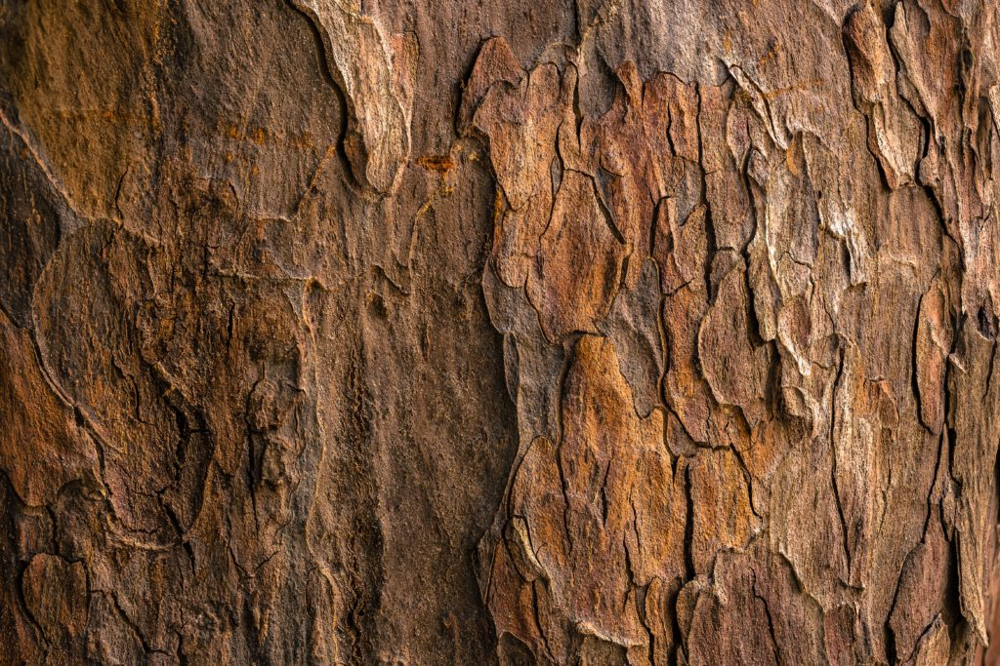

In [3]:
image = cv.imread('0804.jpg')
cv2_imshow(image)

# Laplacian filtering

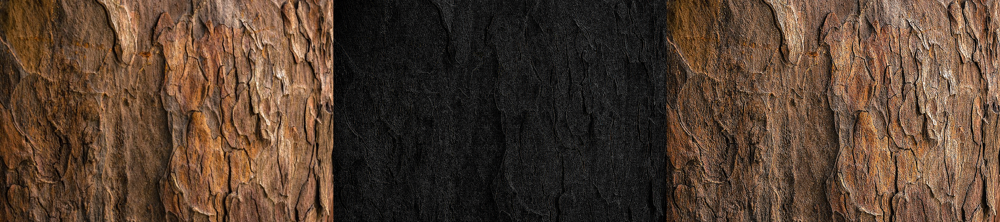

In [6]:
def Laplacian(image):
    kernel = np.array([[ 0,-1, 0],
                       [-1, 4,-1],
                       [ 0,-1, 0]])
    
    return cv.filter2D(image, -1, kernel)

def Sharpen(image):
    kernel = np.array([[ 0,-1, 0],
                       [-1, 5,-1],
                       [ 0,-1, 0]])
    
    return cv.filter2D(image, -1, kernel)

laplaced = Laplacian(image)
sharpened = Sharpen(image)
frame = np.concatenate((image, laplaced, sharpened), axis=1)
cv2_imshow(frame)

# Unsharp Masking

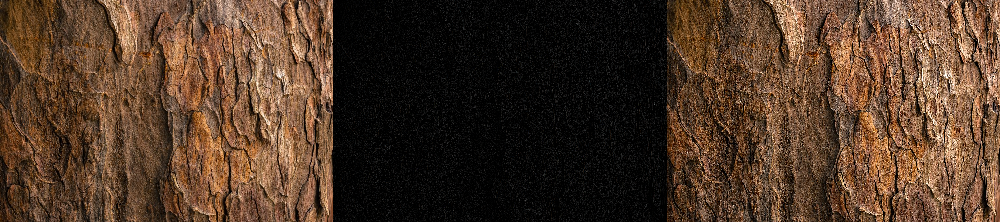

In [10]:
def Unsharp(image):
    gauss = cv.GaussianBlur(image, (5,5), 0)
    mask = cv.addWeighted(image, 1, gauss, -1, 0)
    unsharp = cv.addWeighted(image, 2, gauss, -1, 0)
    return mask, unsharp

mask, unsharp = Unsharp(image)
frame = np.concatenate((image, mask, unsharpen), axis=1)
cv2_imshow(frame)

# Highboost filtering

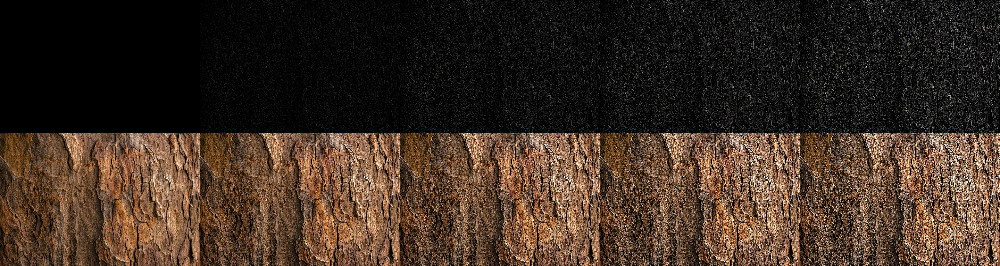

In [16]:
def Highboost(image, k=1):
    gauss = cv.GaussianBlur(image, (5,5), 0)
    mask = cv.addWeighted(image, k, gauss, -k, 0)
    highboost = cv.addWeighted(image, 1+k, gauss, -k, 0)
    return mask, highboost

n = 4
black = np.zeros_like(image)
mask = [None] * n
highboost = [None] * n
for i in range(n):
    mask[i], highboost[i] = Highboost(image, k=i+1)
frame1 = np.concatenate((black, *mask), axis=1)
frame2 = np.concatenate((image, *highboost), axis=1)
frame = np.concatenate((frame1, frame2), axis=0)
cv2_imshow(frame)

# original and highboost k = 1 ~ 4
# k = 1 is same as unsharp masking

# Unsharp masking with k < 0

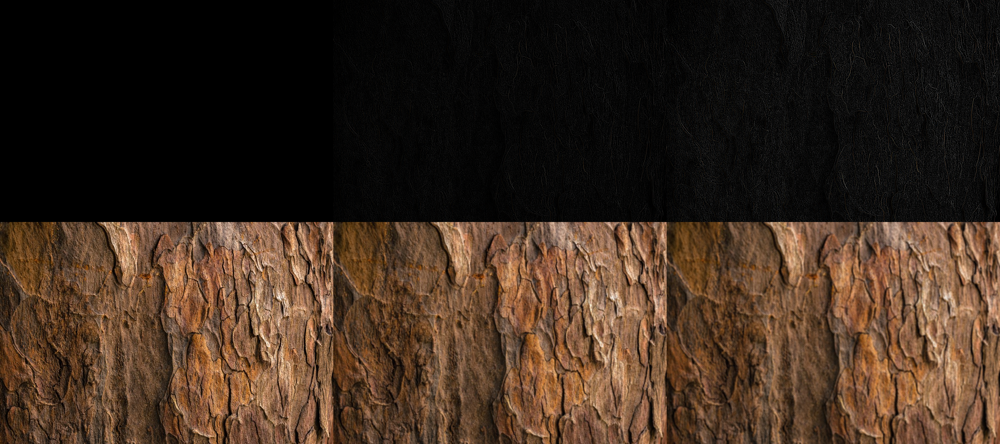

In [18]:
def Highboost(image, k=1):
    gauss = cv.GaussianBlur(image, (5,5), 0)
    mask = cv.addWeighted(image, k, gauss, -k, 0)
    highboost = cv.addWeighted(image, 1+k, gauss, -k, 0)
    return mask, highboost

n = 2
black = np.zeros_like(image)
mask = [None] * n
highboost = [None] * n
for i in range(0, -n, -1):
    mask[i], highboost[i] = Highboost(image, k=i-1)
frame1 = np.concatenate((black, *mask), axis=1)
frame2 = np.concatenate((image, *highboost), axis=1)
frame = np.concatenate((frame1, frame2), axis=0)
cv2_imshow(frame)

# original and unsharp k = -1 ~ -2
# k = -1 is same as gaussian blur